# Capstone Project 2: Exploratory Data Analysis and Outlier Detection

## Introduction

This notebook focuses on conducting a thorough Exploratory Data Analysis (EDA) and detecting and handling outliers for the capstone project. The goal is to understand the data deeply, identify any anomalies, and ensure that the dataset is clean and suitable for further analysis and modeling.

## 1. Data Loading

- **Objective**: Load the dataset into the environment and display the first few rows to get an initial understanding of the data.
- **Tools**: Use pandas to load the data and inspect the first few rows with the `head()` function.

## 2. Data Overview

- **Objective**: Obtain a concise summary of the dataset to understand the data types, non-null counts, and memory usage.
- **Tools**: Use the `info()` method to get the dataset's overall structure and the `describe()` method for statistical summary of numerical features.

## 3. Exploratory Data Analysis (EDA)

- **Objective**: Conduct a detailed analysis to understand the distribution of data, relationships between variables, and potential grouping.
- **Tools**:
  - **Histograms** and **box plots** to analyze distributions and identify outliers in numerical data.
  - **Bar charts** for categorical data.
  - **Pair plots** and **correlation matrices** to understand relationships and multicollinearity between variables.

## 4. Outlier Detection

- **Objective**: Detect outliers using statistical methods and visualizations.
- **Tools**:
  - **Box plots** and **scatter plots** to visualize outliers.
  - **Z-score** and **IQR score** methods to statistically identify outliers.

## 5. Outlier Handling

- **Objective**: Decide on a strategy to handle outliers such as removing, replacing, or keeping them depending on their impact on the dataset.
- **Tools**:
  - For removal, use conditional filtering based on the outlier thresholds identified in the previous step.
  - For replacement, consider methods like imputation with the median or mean, depending on the distribution.

## 6. Final Overview

- **Objective**: Conduct a final inspection of the dataset after cleaning and outlier handling.
- **Tools**: Use `info()`, `describe()`, and visual plots to ensure the data is clean and ready for modeling.

## Conclusion

Summarize the findings from the EDA, the impact of handling outliers, and the final state of the dataset. Outline the next steps for further analysis or modeling based on this cleaned dataset.


# 1. Data Loading
Let's load all datasets.

In [167]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import os

In [140]:
# Load all datasets from 2014 to 2018

data_2014 = pd.read_csv('../data/processed_data/cleaned_df_2014.csv')
data_2015 = pd.read_csv('../data/processed_data/cleaned_df_2015.csv')
data_2016 = pd.read_csv('../data/processed_data/cleaned_df_2016.csv')
data_2017 = pd.read_csv('../data/processed_data/cleaned_df_2017.csv')
data_2018 = pd.read_csv('../data/processed_data/cleaned_df_2018.csv')

all_datasets = {
    '2014':data_2014,
    '2015':data_2015,
    '2016':data_2016,
    '2017':data_2017,
    '2018':data_2018
}

In [141]:
all_datasets['2014'].head(2)

,Revenue,Revenue Growth,Cost of Revenue,Gross Profit,R&D Expenses,SG&A Expense,Operating Expenses,Operating Income,Interest Expense,Earnings before Tax,...,Receivables growth,Inventory Growth,Asset Growth,Book Value per Share Growth,Debt Growth,R&D Expense Growth,SG&A Expenses Growth,2015 PRICE VAR [%],Symbol,Sector
0,7.440100e+10,-0.0713,3.903000e+10,3.537100e+10,0.000000e+00,2.146100e+10,2.146100e+10,1.391000e+10,7.090000e+08,1.449400e+10,...,-0.01870,-0.0217,0.03590,0.03160,0.12280,0.0000,-0.1746,-9.323276,PG,Consumer Defensive
1,3.734148e+09,1.1737,2.805625e+09,9.285226e+08,1.083303e+08,3.441414e+08,7.939267e+08,1.345959e+08,1.214869e+07,1.753823e+08,...,0.14502,-0.0010,0.13912,-0.12502,0.54302,1.6484,1.7313,-25.512193,VIPS,Consumer Defensive


In [142]:
all_datasets['2015'].head(2)

,Revenue,Revenue Growth,Cost of Revenue,Gross Profit,R&D Expenses,SG&A Expense,Operating Expenses,Operating Income,Interest Expense,Earnings before Tax,...,Receivables growth,Inventory Growth,Asset Growth,Book Value per Share Growth,Debt Growth,R&D Expense Growth,SG&A Expenses Growth,2016 PRICE VAR [%],Symbol,Sector
0,7.074900e+10,-0.0491,3.705600e+10,3.369300e+10,0.000000e+00,2.061600e+10,2.264400e+10,1.104900e+10,6.260000e+08,9.761000e+09,...,-0.2847,-0.2634,-0.1024,-0.1013,-0.1432,0.0000,-0.0394,10.809451,PG,Consumer Defensive
1,6.193685e+09,0.6587,4.669038e+09,1.524648e+09,1.658481e+08,5.223879e+08,1.205660e+09,3.189877e+08,1.321245e+07,3.154229e+08,...,28.6759,0.2144,0.1279,0.2946,0.0281,0.5309,0.5179,-21.637010,VIPS,Consumer Defensive


In [143]:
all_datasets['2016'].head(2)

,Revenue,Revenue Growth,Cost of Revenue,Gross Profit,R&D Expenses,SG&A Expense,Operating Expenses,Operating Income,Interest Expense,Earnings before Tax,...,Receivables growth,Inventory Growth,Asset Growth,Book Value per Share Growth,Debt Growth,R&D Expense Growth,SG&A Expenses Growth,2017 PRICE VAR [%],Symbol,Sector
0,6.529900e+10,-0.0770,3.290900e+10,3.239000e+10,0.000000e+00,1.894900e+10,1.894900e+10,1.344100e+10,5.790000e+08,1.385000e+10,...,-0.0427,-0.0528,-0.0182,-0.0627,0.0083,0.0000,-0.0809,12.532463,PG,Consumer Defensive
1,8.148496e+09,0.3156,6.190740e+09,1.957756e+09,2.251378e+08,6.880959e+08,1.567877e+09,3.898789e+08,1.226710e+07,3.799345e+08,...,0.9234,0.0128,0.1706,0.5109,-0.0139,0.3575,0.3172,4.363319,VIPS,Consumer Defensive


In [144]:
all_datasets['2017'].head(2)

,Revenue,Revenue Growth,Cost of Revenue,Gross Profit,R&D Expenses,SG&A Expense,Operating Expenses,Operating Income,Interest Expense,Earnings before Tax,...,Receivables growth,Inventory Growth,Asset Growth,Book Value per Share Growth,Debt Growth,R&D Expense Growth,SG&A Expenses Growth,2018 PRICE VAR [%],Symbol,Sector
0,6.505800e+10,-0.0037,3.263800e+10,3.242000e+10,0.000000e+00,1.865400e+10,1.865400e+10,1.376600e+10,4.650000e+08,1.838900e+10,...,0.0505,-0.0195,-0.0529,0.0012,0.0325,0.0000,-0.0156,4.975151,PG,Consumer Defensive
1,1.102060e+10,0.3525,8.557810e+09,2.462794e+09,2.733452e+08,8.201852e+08,2.056136e+09,4.066575e+08,1.245995e+07,3.893281e+08,...,0.9219,0.4764,0.5889,1.5821,0.3805,0.2141,0.1920,-56.320000,VIPS,Consumer Defensive


In [145]:
all_datasets['2018'].head(2)

,Revenue,Revenue Growth,Cost of Revenue,Gross Profit,R&D Expenses,SG&A Expense,Operating Expenses,Operating Income,Interest Expense,Earnings before Tax,...,Receivables growth,Inventory Growth,Asset Growth,Book Value per Share Growth,Debt Growth,R&D Expense Growth,SG&A Expenses Growth,2019 PRICE VAR [%],Symbol,Sector
0,9.450700e+10,0.1115,0.000000e+00,9.450700e+10,0.0,6.482200e+10,7.549800e+10,1.900900e+10,3.542000e+09,1.511100e+10,...,0.2570,0.000,0.3426,0.0722,0.7309,0.0,0.1308,32.794573,CMCSA,Consumer Cyclical
1,1.414400e+10,0.0320,7.288000e+09,6.856000e+09,0.0,6.010000e+08,3.062000e+09,3.794000e+09,1.917000e+09,2.196000e+09,...,0.0345,-0.092,-0.0024,0.0076,-0.0137,0.0,-0.1265,40.588068,KMI,Energy


## 2. Data Overview

In [146]:
# Overview of each dataset
for year, dataset in all_datasets.items():
    print(f"Overview of the dataset for the year {year}")
    dataset.info()
    display(dataset.describe())


Overview of the dataset for the year 2014
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3808 entries, 0 to 3807
Columns: 181 entries, Revenue to Sector
dtypes: float64(179), object(2)
memory usage: 5.3+ MB


,Revenue,Revenue Growth,Cost of Revenue,Gross Profit,R&D Expenses,SG&A Expense,Operating Expenses,Operating Income,Interest Expense,Earnings before Tax,...,3Y Shareholders Equity Growth (per Share),3Y Dividend per Share Growth (per Share),Receivables growth,Inventory Growth,Asset Growth,Book Value per Share Growth,Debt Growth,R&D Expense Growth,SG&A Expenses Growth,2015 PRICE VAR [%]
count,3.808000e+03,3808.000000,3.808000e+03,3.808000e+03,3.808000e+03,3.808000e+03,3.808000e+03,3.808000e+03,3.808000e+03,3.808000e+03,...,3808.000000,3808.000000,3808.000000,3808.000000,3808.000000,3808.000000,3808.000000,3808.000000,3808.000000,3.808000e+03
mean,5.836329e+09,16.692694,3.651784e+09,2.180310e+09,9.207066e+07,9.209443e+08,1.450941e+09,7.003913e+08,9.950684e+07,5.779697e+08,...,0.096831,0.034750,4.305805,0.170293,2.156142,0.835262,1.304901,0.901756,0.382547,9.751560e+02
std,3.879859e+10,710.077646,3.012101e+10,1.152628e+10,6.297364e+08,4.785096e+09,7.455824e+09,3.905624e+09,6.937910e+08,2.823892e+09,...,0.407580,0.242320,154.997882,2.140071,88.842524,24.494970,17.991825,26.962482,4.603697,4.098461e+04
min,-6.276160e+08,-1.773200,-5.455740e+08,-1.105000e+09,-1.500000e+05,0.000000e+00,-1.088448e+09,-6.786000e+09,-2.250000e+08,-8.878000e+09,...,-0.846400,-1.000000,-1.000000,-1.000000,-0.979600,-230.000000,-1.051000,-1.043700,-1.000000,-1.003972e+02
25%,5.683167e+07,-0.001125,3.177338e+06,3.085278e+07,0.000000e+00,1.547725e+07,3.083611e+07,-1.000000e+06,0.000000e+00,-3.456500e+06,...,-0.002925,0.000000,-0.044125,0.000000,-0.010700,-0.076325,-0.046705,0.000000,-0.001925,-2.857143e+01
50%,4.271125e+08,0.063550,1.368085e+08,1.907405e+08,0.000000e+00,7.387600e+07,1.379415e+08,4.093850e+07,2.487500e+06,2.859300e+07,...,0.047800,0.000000,0.019800,0.000000,0.064500,0.039290,0.000000,0.000000,0.071100,-5.281842e+00
75%,2.380804e+09,0.192200,1.169804e+09,8.915462e+08,1.054550e+07,3.475070e+08,5.835500e+08,2.710448e+08,4.254100e+07,2.162982e+08,...,0.115925,0.045275,0.210325,0.065025,0.222405,0.146700,0.228655,0.022400,0.222250,1.331484e+01
max,1.824698e+12,42138.663900,1.537249e+12,4.621600e+11,1.153700e+10,1.856830e+11,3.056050e+11,1.565540e+11,3.152300e+10,8.720500e+10,...,12.439600,3.605800,9328.200000,76.625000,5468.426400,1360.125000,729.576600,1542.611000,225.690000,2.418601e+06


Overview of the dataset for the year 2015
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4120 entries, 0 to 4119
Columns: 181 entries, Revenue to Sector
dtypes: float64(179), object(2)
memory usage: 5.7+ MB


,Revenue,Revenue Growth,Cost of Revenue,Gross Profit,R&D Expenses,SG&A Expense,Operating Expenses,Operating Income,Interest Expense,Earnings before Tax,...,3Y Shareholders Equity Growth (per Share),3Y Dividend per Share Growth (per Share),Receivables growth,Inventory Growth,Asset Growth,Book Value per Share Growth,Debt Growth,R&D Expense Growth,SG&A Expenses Growth,2016 PRICE VAR [%]
count,4.120000e+03,4120.000000,4.120000e+03,4.120000e+03,4.120000e+03,4.120000e+03,4.120000e+03,4.120000e+03,4.120000e+03,4.120000e+03,...,4120.000000,4120.000000,4120.000000,4120.000000,4120.000000,4120.000000,4120.000000,4120.000000,4120.000000,4120.000000
mean,4.946039e+09,0.284166,3.109713e+09,1.868882e+09,9.339839e+07,8.326055e+08,1.358813e+09,5.052920e+08,9.302892e+07,4.036599e+08,...,0.065655,0.009734,0.695758,0.136143,0.410148,3.496996,2.630925,0.286827,0.319612,103.077642
std,3.428321e+10,3.440890,2.772970e+10,8.338745e+09,6.550761e+08,3.449717e+09,5.165383e+09,2.764110e+09,5.214156e+08,2.405919e+09,...,0.435585,0.258052,6.838411,2.974689,4.019191,120.364654,87.004767,5.429595,5.644778,3756.530836
min,-3.357020e+08,-1.064300,-2.665346e+09,-1.280800e+10,-4.179153e+06,0.000000e+00,-5.495512e+09,-1.933900e+10,-1.710954e+09,-1.910900e+10,...,-0.967800,-1.000000,-1.000000,-1.000000,-0.996400,-379.478300,-1.000000,-1.000000,-0.991200,-99.947830
25%,5.527603e+07,-0.051900,3.005769e+06,2.703950e+07,0.000000e+00,1.498275e+07,3.258475e+07,-5.762998e+06,0.000000e+00,-1.059650e+07,...,-0.019700,0.000000,-0.101100,-0.016600,-0.048325,-0.124225,-0.063000,0.000000,-0.032000,-5.172844
50%,3.986455e+08,0.032750,1.309275e+08,1.745606e+08,0.000000e+00,7.268300e+07,1.428080e+08,2.998884e+07,2.653796e+06,1.833596e+07,...,0.031050,0.000000,0.000000,0.000000,0.036600,0.011670,0.000000,0.000000,0.054450,17.278935
75%,2.170945e+09,0.160040,1.098380e+09,8.148728e+08,1.142988e+07,3.454255e+08,6.039335e+08,2.303962e+08,4.258027e+07,1.656352e+08,...,0.103930,0.033020,0.161525,0.027625,0.175105,0.114600,0.179290,0.005220,0.192765,40.567983
max,1.886894e+12,189.817900,1.581527e+12,3.053670e+11,1.306700e+10,9.341800e+10,9.341800e+10,7.123000e+10,1.844600e+10,7.251500e+10,...,20.036700,3.941000,220.341000,170.427600,153.720000,7039.325900,5443.000000,297.736800,324.926800,212700.011623


Overview of the dataset for the year 2016
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4797 entries, 0 to 4796
Columns: 181 entries, Revenue to Sector
dtypes: float64(179), object(2)
memory usage: 6.6+ MB


,Revenue,Revenue Growth,Cost of Revenue,Gross Profit,R&D Expenses,SG&A Expense,Operating Expenses,Operating Income,Interest Expense,Earnings before Tax,...,3Y Shareholders Equity Growth (per Share),3Y Dividend per Share Growth (per Share),Receivables growth,Inventory Growth,Asset Growth,Book Value per Share Growth,Debt Growth,R&D Expense Growth,SG&A Expenses Growth,2017 PRICE VAR [%]
count,4.797000e+03,4797.000000,4.797000e+03,4.797000e+03,4.797000e+03,4.797000e+03,4.797000e+03,4.797000e+03,4.797000e+03,4.797000e+03,...,4797.000000,4797.000000,4797.000000,4797.000000,4797.000000,4797.000000,4797.000000,4797.000000,4797.000000,4.797000e+03
mean,5.823662e+09,1.478652,2.996924e+09,1.853714e+09,9.918879e+07,9.421117e+08,1.515850e+09,5.601269e+08,1.012365e+08,4.366091e+08,...,0.036777,0.008432,0.749835,0.161716,0.650616,1.542693,2.965091,0.143070,0.282050,3.650260e+02
std,3.131161e+10,48.840478,2.522787e+10,7.576366e+09,6.885702e+08,3.502163e+09,4.829562e+09,2.461584e+09,4.211568e+08,2.101815e+09,...,0.290159,0.254424,19.997237,3.548281,13.343636,84.370069,50.312239,3.354135,3.251389,1.940149e+04
min,-3.819270e+08,-12.769300,-2.639031e+09,-3.564190e+09,-8.610000e+07,-5.207792e+07,-9.357000e+08,-6.770000e+09,-1.107000e+09,-7.621000e+09,...,-0.948900,-1.000000,-1.000000,-1.000000,-1.000000,-3963.131200,-1.000000,-2.662200,-2.099000,-9.999941e+01
25%,6.111900e+07,-0.040400,5.927000e+06,3.193100e+07,0.000000e+00,1.768800e+07,3.650900e+07,-3.025000e+06,0.000000e+00,-7.573000e+06,...,-0.036900,0.000000,-0.041220,-0.011400,-0.029100,-0.112900,-0.065860,0.000000,-0.020200,-6.730768e+00
50%,5.164110e+08,0.045700,1.945140e+08,2.281730e+08,0.000000e+00,9.224800e+07,1.784380e+08,4.420400e+07,5.398000e+06,2.549100e+07,...,0.019600,0.000000,0.021800,0.000000,0.044800,0.028000,0.000000,0.000000,0.049600,1.090686e+01
75%,3.563573e+09,0.196300,1.430646e+09,9.395000e+08,1.532500e+07,4.378947e+08,9.305390e+08,3.069290e+08,6.066900e+07,1.938070e+08,...,0.083900,0.052300,0.202600,0.032840,0.146300,0.121100,0.146660,0.018900,0.172400,3.155634e+01
max,1.822805e+12,3234.456800,1.548384e+12,2.744210e+11,1.608500e+10,9.704100e+10,9.704100e+10,6.002400e+10,1.517600e+10,6.137200e+10,...,10.492400,5.400500,1340.695700,217.041700,636.156900,3710.666700,2893.736800,224.818200,122.895700,1.321281e+06


Overview of the dataset for the year 2017
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4960 entries, 0 to 4959
Columns: 181 entries, Revenue to Sector
dtypes: float64(179), object(2)
memory usage: 6.8+ MB


,Revenue,Revenue Growth,Cost of Revenue,Gross Profit,R&D Expenses,SG&A Expense,Operating Expenses,Operating Income,Interest Expense,Earnings before Tax,...,3Y Shareholders Equity Growth (per Share),3Y Dividend per Share Growth (per Share),Receivables growth,Inventory Growth,Asset Growth,Book Value per Share Growth,Debt Growth,R&D Expense Growth,SG&A Expenses Growth,2018 PRICE VAR [%]
count,4.960000e+03,4960.000000,4.960000e+03,4.960000e+03,4.960000e+03,4.960000e+03,4.960000e+03,4.960000e+03,4.960000e+03,4.960000e+03,...,4960.000000,4960.000000,4960.000000,4960.000000,4960.000000,4960.000000,4960.000000,4960.000000,4960.000000,4960.000000
mean,5.808245e+09,0.924474,3.087270e+09,2.219538e+09,1.015287e+08,8.393840e+08,1.323582e+09,6.459399e+08,9.496764e+07,4.790269e+08,...,0.037629,0.008268,31.693634,0.109231,1.497708,0.245002,1.332826,0.391952,0.621868,-4.461547
std,3.023068e+10,17.695053,2.441285e+10,7.794731e+09,7.446132e+08,3.321819e+09,4.943784e+09,2.672729e+09,3.953286e+08,2.244768e+09,...,0.260441,0.232779,450.630077,0.996793,33.767701,4.185570,30.929246,12.633722,29.053204,561.802215
min,-3.004500e+07,-6.872700,-2.986888e+09,-8.138230e+08,-1.098000e+08,-1.043667e+08,-1.088000e+09,-1.868300e+10,-1.932443e+08,-1.819800e+10,...,-0.962400,-1.000000,-1.000000,-1.000000,-1.000000,-221.000000,-1.000000,-1.218100,-2.369900,-99.999115
25%,7.068500e+07,0.000475,7.539709e+06,3.850200e+07,0.000000e+00,1.981100e+07,4.038650e+07,-2.968750e+06,4.181500e+03,-5.222741e+06,...,-0.032725,0.000000,-0.006925,0.000000,0.003150,-0.035050,-0.059600,0.000000,0.000000,-33.388915
50%,5.882170e+08,0.083300,2.097455e+08,2.659980e+08,0.000000e+00,1.027053e+08,1.939585e+08,4.806350e+07,7.525000e+06,3.635950e+07,...,0.031100,0.000000,0.063690,0.000000,0.072070,0.077910,0.000000,0.000000,0.067450,-13.336397
75%,3.765482e+09,0.218775,1.405700e+09,1.462125e+09,1.532520e+07,4.358372e+08,6.930402e+08,3.615738e+08,5.611525e+07,2.001200e+08,...,0.094000,0.051440,0.249725,0.091225,0.192510,0.211875,0.165045,0.021625,0.168800,2.124593
max,1.695864e+12,825.959800,1.465577e+12,2.302870e+11,2.262000e+10,1.018530e+11,1.018530e+11,6.513565e+10,1.340100e+10,6.408900e+10,...,5.631800,3.561000,18499.000000,43.553400,2014.273300,84.127700,1981.061600,837.000000,2042.000000,39219.999109


Overview of the dataset for the year 2018
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4392 entries, 0 to 4391
Columns: 181 entries, Revenue to Sector
dtypes: float64(179), object(2)
memory usage: 6.1+ MB


,Revenue,Revenue Growth,Cost of Revenue,Gross Profit,R&D Expenses,SG&A Expense,Operating Expenses,Operating Income,Interest Expense,Earnings before Tax,...,3Y Shareholders Equity Growth (per Share),3Y Dividend per Share Growth (per Share),Receivables growth,Inventory Growth,Asset Growth,Book Value per Share Growth,Debt Growth,R&D Expense Growth,SG&A Expenses Growth,2019 PRICE VAR [%]
count,4.392000e+03,4392.000000,4.392000e+03,4.392000e+03,4.392000e+03,4.392000e+03,4.392000e+03,4.392000e+03,4.392000e+03,4.392000e+03,...,4392.000000,4392.000000,4392.000000,4392.000000,4392.000000,4392.000000,4392.000000,4392.000000,4392.000000,4392.000000
mean,5.097590e+09,3.350747,3.148079e+09,2.034845e+09,1.215953e+08,9.354013e+08,1.465620e+09,6.508501e+08,9.894350e+07,5.564103e+08,...,0.042588,0.006719,35.933939,0.176573,1.619083,0.282010,9.347399,0.089362,0.160575,20.803948
std,2.039912e+10,192.386481,1.491432e+10,7.641165e+09,9.196490e+08,3.727593e+09,5.560456e+09,2.958291e+09,3.735102e+08,2.621289e+09,...,0.435925,0.232812,2313.711841,4.562719,36.382543,5.536458,352.622614,0.806902,0.857613,82.622147
min,-6.894100e+07,-3.461500,-2.669055e+09,-1.818220e+09,-1.042000e+08,-1.401594e+08,-4.280000e+09,-1.455700e+10,-1.408252e+09,-2.177200e+10,...,-0.981000,-1.000000,-1.000000,-1.000000,-0.999100,-32.258100,-1.000000,-1.000000,-1.000000,-99.864779
25%,6.472375e+07,0.000000,4.163543e+06,3.579028e+07,0.000000e+00,1.949450e+07,4.067675e+07,-5.368588e+06,0.000000e+00,-9.795315e+06,...,-0.037450,0.000000,-0.046025,0.000000,-0.037300,-0.103950,-0.080050,0.000000,-0.003225,-7.477173
50%,4.958965e+08,0.075250,1.702142e+08,2.182820e+08,0.000000e+00,9.223750e+07,1.803455e+08,4.200600e+07,5.531392e+06,2.725550e+07,...,0.027000,0.000000,0.013900,0.000000,0.034650,0.025150,0.000000,0.000000,0.066100,17.639393
75%,2.457529e+09,0.187620,1.307878e+09,9.676272e+08,1.432375e+07,4.251662e+08,6.844232e+08,2.836815e+08,5.746975e+07,2.240622e+08,...,0.100825,0.046800,0.192950,0.080925,0.155100,0.137325,0.119695,0.011475,0.167625,39.625879
max,5.003430e+11,12739.000000,3.733960e+11,1.269470e+11,2.883700e+10,1.065100e+11,1.065100e+11,7.089800e+10,9.168000e+09,7.290300e+10,...,18.315600,4.079100,153332.333300,293.473000,1184.993800,313.395800,17646.823500,36.898100,43.718800,3756.716345


## 3. Exploratory Data Analysis (EDA)

Let's make some boxplots and histograms.

In [147]:
def plot_financial_data(df, column, num_bins=50):
    # Plotting
    plt.figure(figsize=(12, 6))

    # Histogram
    plt.subplot(1, 2, 1)
    sns.histplot(df[column], bins=num_bins, kde=False, color='blue')
    plt.title(f'Histogram of {column}')
    plt.xlabel(column)
    plt.ylabel('Frequency')

    # Boxplot
    plt.subplot(1, 2, 2)
    sns.boxplot(x=df[column])
    plt.title(f'Boxplot of {column}')
    plt.xlabel(column)

    plt.tight_layout()
    plt.show()
    plt.close()  # Helps free up memory by closing the plot

def plot_by_year(df):
    
    # Select only numeric columns
    numeric_cols = df.select_dtypes(include=[np.number]).columns

    # Plot data for each numeric column
    for column in numeric_cols:
        plot_financial_data(df, column)

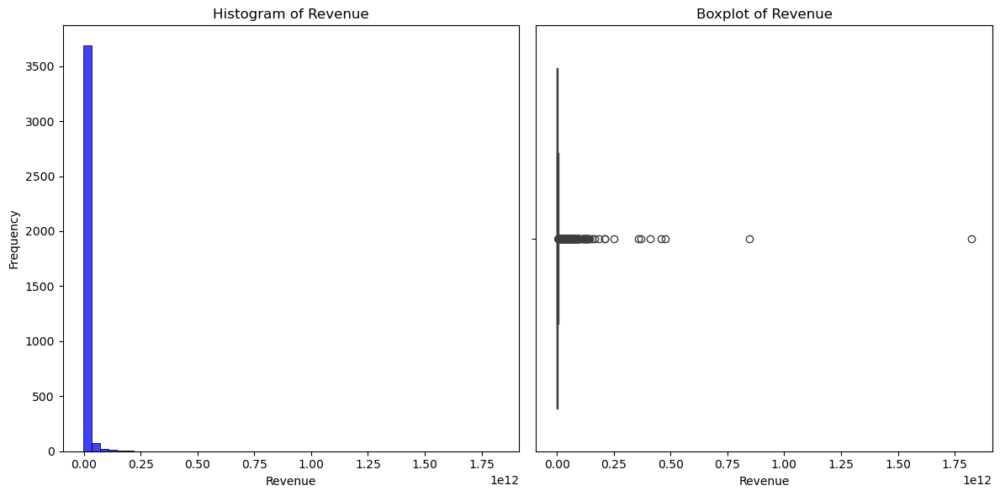

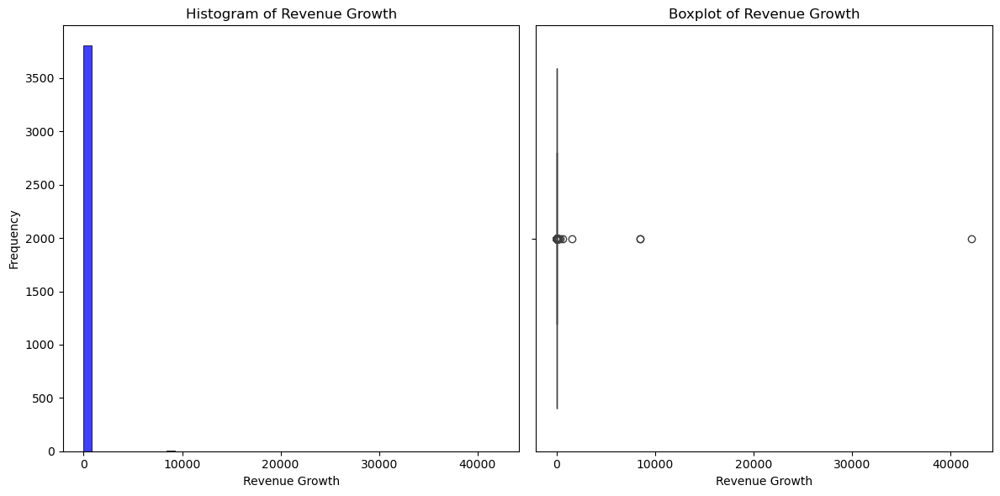

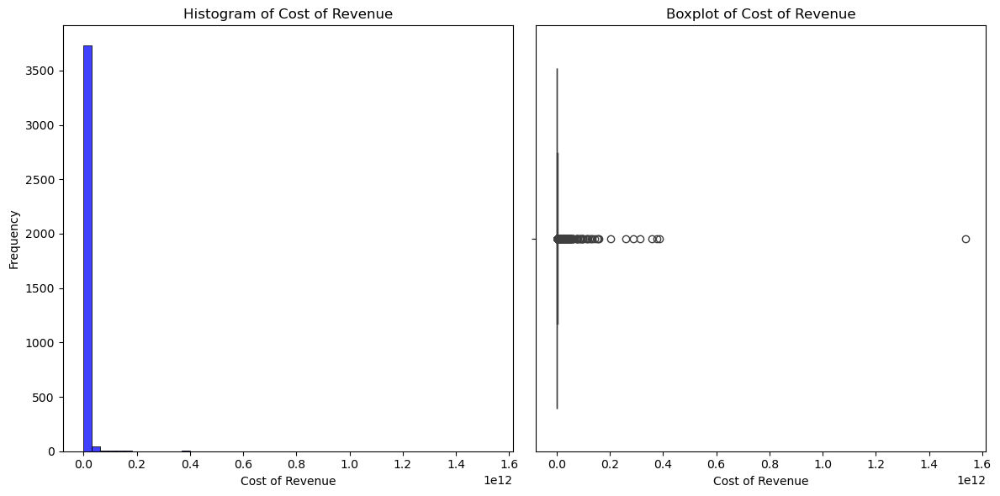

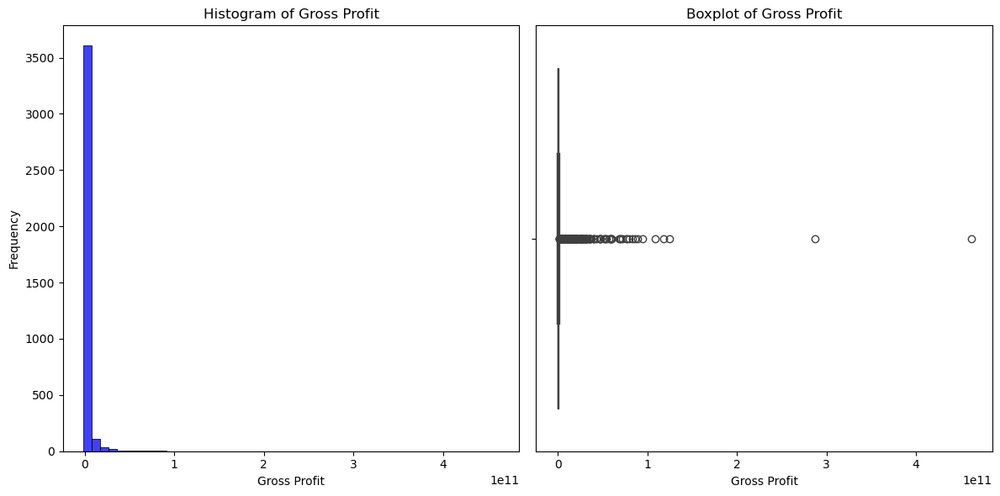

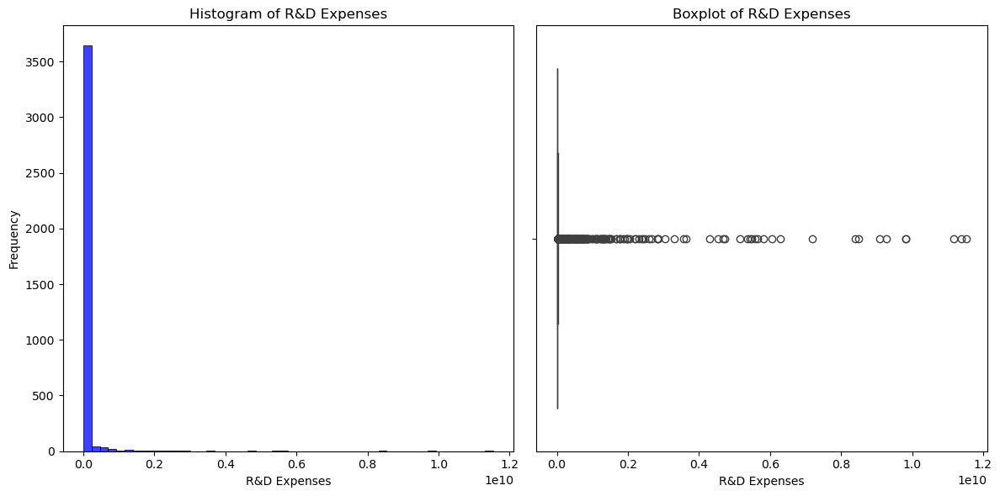

...

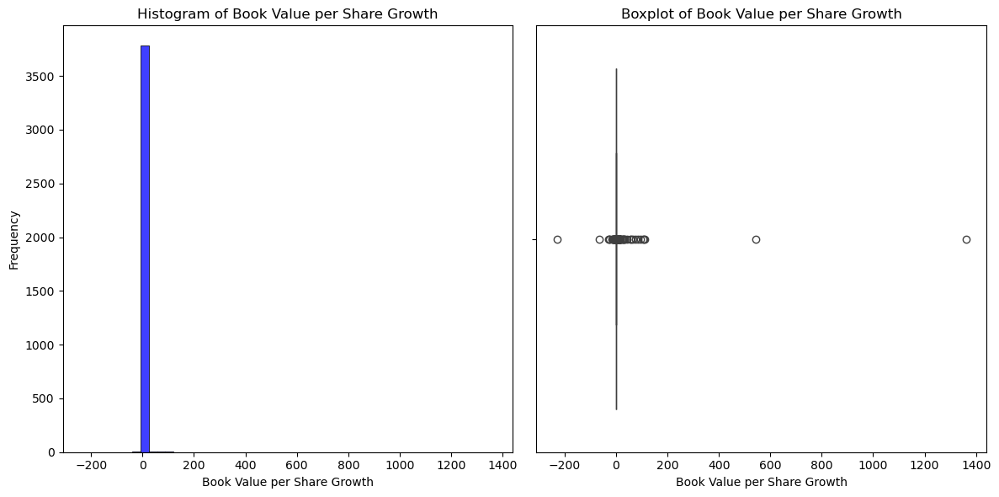

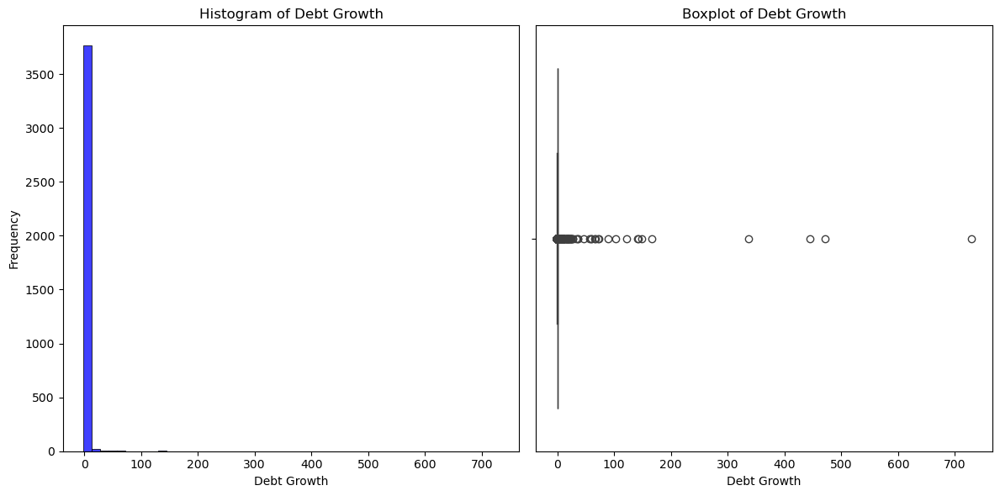

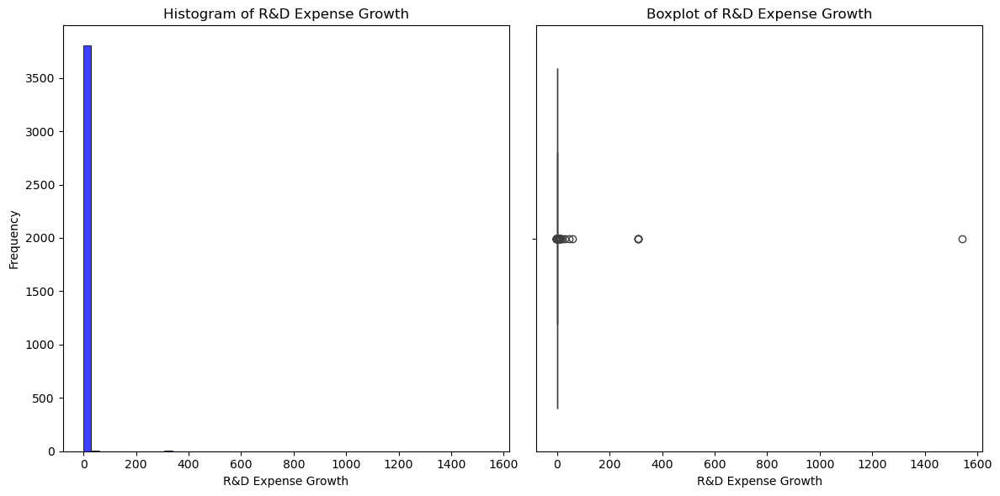

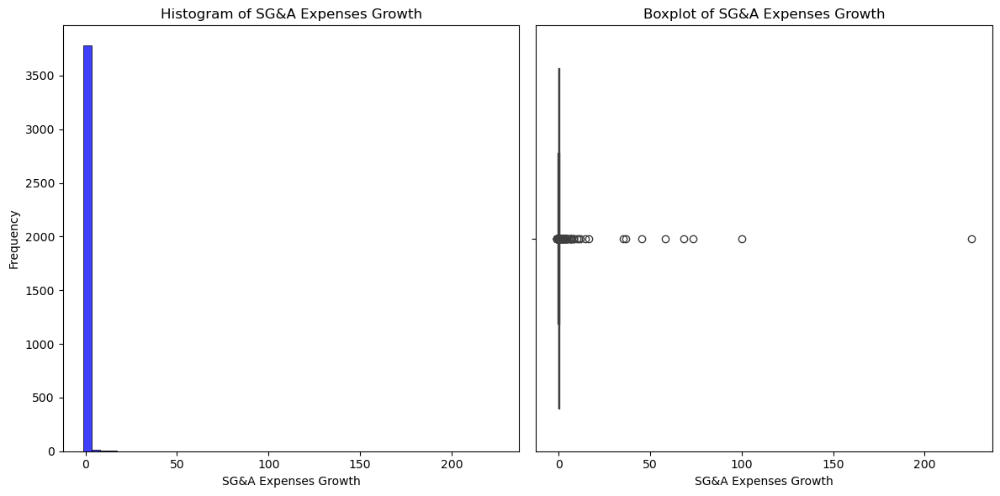

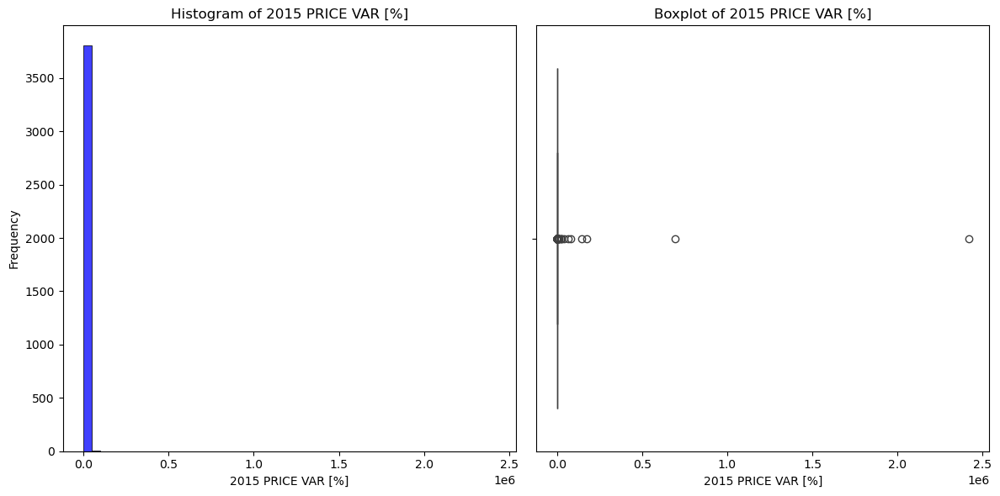

In [148]:
plot_by_year(all_datasets['2014'])

### Data Characteristics and Handling Outliers

The dataset exhibits significant skewness with multiple outliers. These anomalies can be attributed to the varying market capitalization profiles and sizes of the companies included. Considering this, it would not be prudent to remove these outliers, as they may hold valuable information pertinent to our analysis and goals.


This is a util function to save the datasets

In [168]:
def save_datasets_to_csv(all_datasets, output_directory):
    """
    Saves the DataFrames in all_datasets to CSV files in the specified output directory.
    
    Args:
    all_datasets (dict): Dictionary of DataFrames with keys as years and values as DataFrames.
    output_directory (str): Directory to save the processed DataFrames.
    
    Returns:
    None
    """
    # Ensure the output directory exists
    os.makedirs(output_directory, exist_ok=True)

    # Iterate over each dataset and save it to a CSV file
    for year, df in all_datasets.items():
        output_path = os.path.join(output_directory, f'cleaned_df_{year}.csv')
        df.to_csv(output_path, index=False)
        print(f'Data from {year} saved to {output_path}')

### Handling Outliers

To address the presence of outliers in our dataset, we will create three distinct datasets for analysis:

1. **Original Dataset**: No outliers will be removed or modified.
2. **Capped Dataset**: Outliers will be capped at the 1st and 99th percentiles.
3. **Trimmed Dataset**: Outliers will be removed, specifically the lowest and highest 1% of values.

We will then proceed to model our data using these different datasets to assess the impact of outlier handling on our results.


**Original Dataset**: No outliers will be removed or modified.

In [170]:
output_directory = '../data/processed_data/data_with_outliers'
save_datasets_to_csv(all_datasets, output_directory)

Data from 2014 saved to ../data/processed_data/data_with_outliers/cleaned_df_2014.csv
Data from 2015 saved to ../data/processed_data/data_with_outliers/cleaned_df_2015.csv
Data from 2016 saved to ../data/processed_data/data_with_outliers/cleaned_df_2016.csv
Data from 2017 saved to ../data/processed_data/data_with_outliers/cleaned_df_2017.csv
Data from 2018 saved to ../data/processed_data/data_with_outliers/cleaned_df_2018.csv


In [162]:
def handle_outliers(df, column, method='iqr', action='cap', factor=1.5, quantile_1=0.25, quantile_3=0.75):
    """
    Handles outliers in a DataFrame column by either capping or dropping them.
    
    Args:
    df (DataFrame): The DataFrame containing the data.
    column (str): The column to process.
    method (str): Method to use for detecting outliers, defaults to 'iqr' (Interquartile Range).
    action (str): Action to take on the outliers, 'cap' to limit their value, 'drop' to remove them.
    factor (float): The multiplier for the IQR to define bounds.
    quantile_1 (float): Lower quantile for calculating IQR, default is 0.25.
    quantile_3 (float): Upper quantile for calculating IQR, default is 0.75.
    
    Returns:
    DataFrame: The DataFrame with outliers handled according to the specified action.
    """
    # Create a copy of the DataFrame to ensure the original is not modified
    df_copy = df.copy()
    if df_copy[column].dtype in ['int64', 'float64']:  # Check if the column is numeric
        # Calculate IQR
        Q1 = df_copy[column].quantile(quantile_1)
        Q3 = df_copy[column].quantile(quantile_3)
        IQR = Q3 - Q1
        
        # Define bounds
        lower_bound = Q1 - factor * IQR
        upper_bound = Q3 + factor * IQR
        
        if action == 'cap':
            # Apply capping
            df_copy[column] = np.where(df_copy[column] < lower_bound, lower_bound, df_copy[column])
            df_copy[column] = np.where(df_copy[column] > upper_bound, upper_bound, df_copy[column])
        elif action == 'drop':
            # Remove outliers
            df_copy = df_copy[(df_copy[column] >= lower_bound) & (df_copy[column] <= upper_bound)]
    
    return df_copy
    
# Applying the function
df_modified = df_original.copy()  # Create a new DataFrame that will store the modified data



### **Capped Dataset**: 
Outliers will be capped at the 1st and 99th percentiles.

In [175]:
# Create a new dictionary to store the modified datasets
modified_datasets = {}

# Apply the function to each dataset in the dictionary
for year, dataset in all_datasets.items():
    df_modified = dataset.copy()
    for column in df_modified.columns:
        if df_modified[column].dtype in ['int64', 'float64']:  # Check if the column is numeric
            df_modified = handle_outliers(df_modified, column, action='cap', factor=2, quantile_1=0.01, quantile_3=0.99)
    modified_datasets[year] = df_modified  # Store the modified DataFrame
    
print(f'Original Dataset:{all_datasets['2015'].shape}, Modified Dataset {modified_datasets['2015'].shape}')

output_directory = '../data/processed_data/data_cap_outliers_1%'
save_datasets_to_csv(all_datasets, output_directory)

Origunal Dataset:(4120, 181),Modified Dataset (4120, 181)
Data from 2014 saved to ../data/processed_data/data_cap_outliers_1%/cleaned_df_2014.csv
Data from 2015 saved to ../data/processed_data/data_cap_outliers_1%/cleaned_df_2015.csv
Data from 2016 saved to ../data/processed_data/data_cap_outliers_1%/cleaned_df_2016.csv
Data from 2017 saved to ../data/processed_data/data_cap_outliers_1%/cleaned_df_2017.csv
Data from 2018 saved to ../data/processed_data/data_cap_outliers_1%/cleaned_df_2018.csv


Let's see year 2014

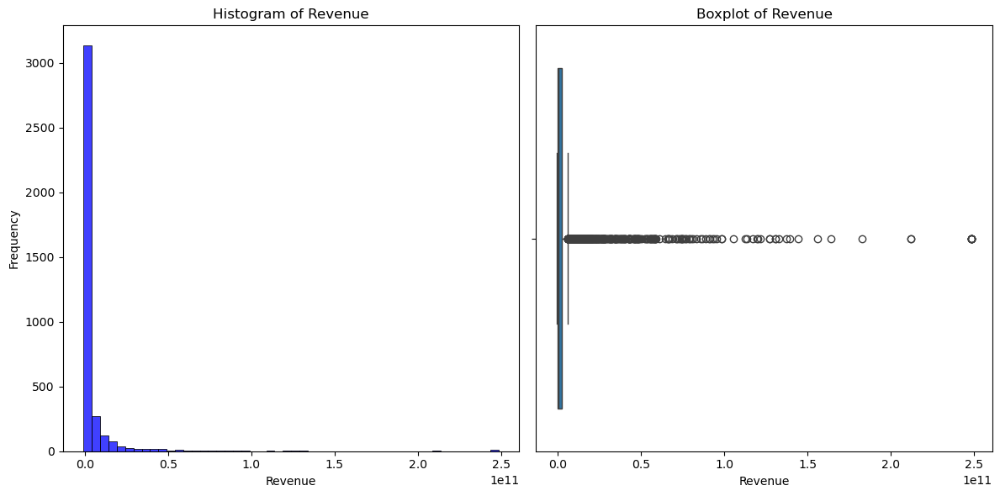

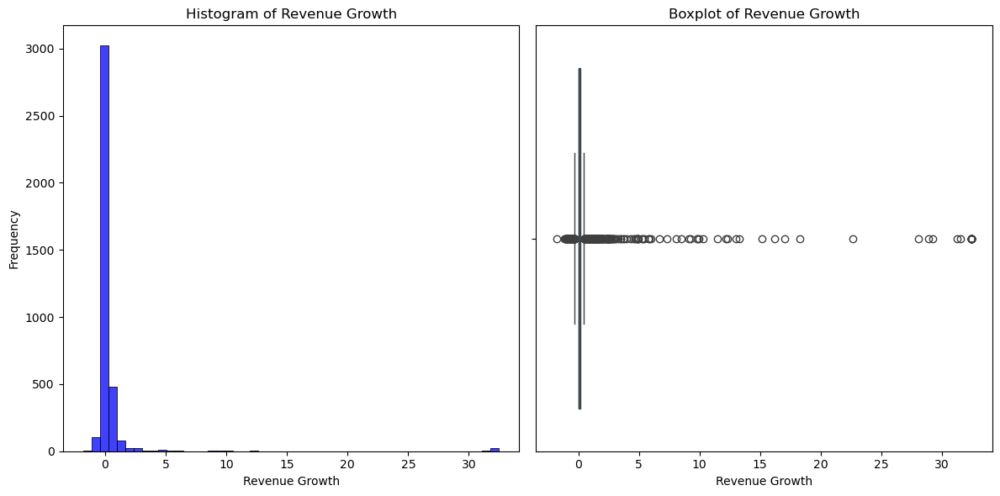

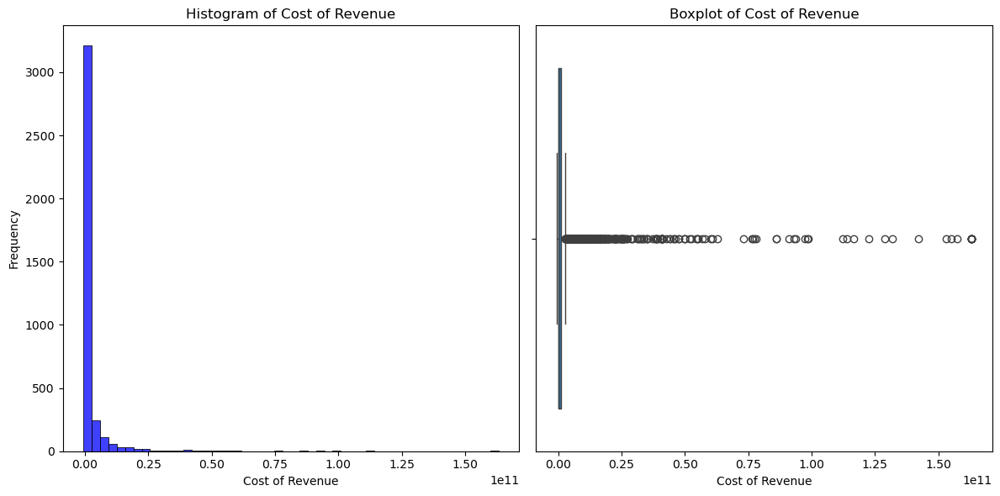

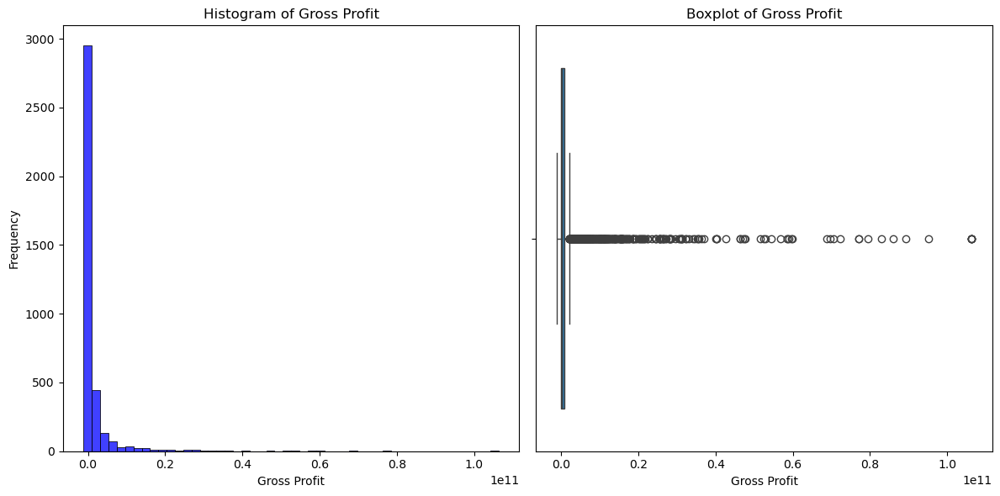

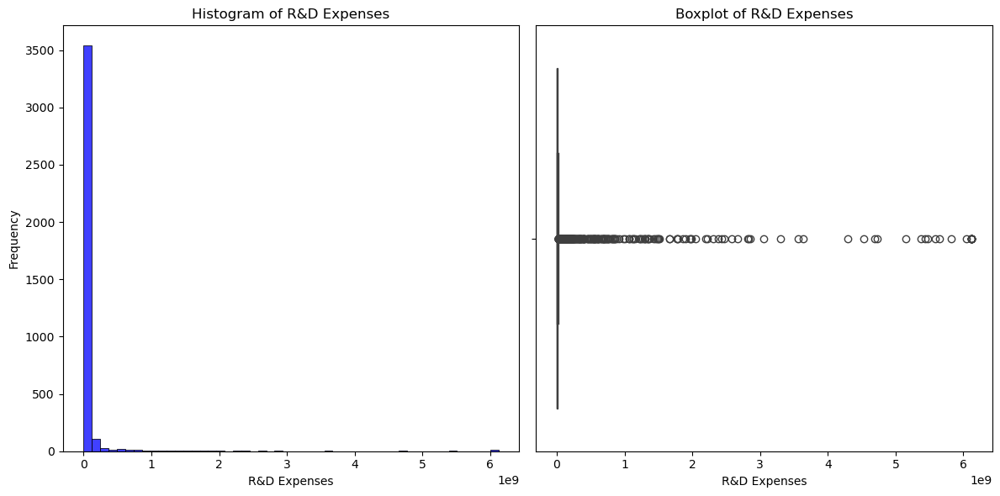

...

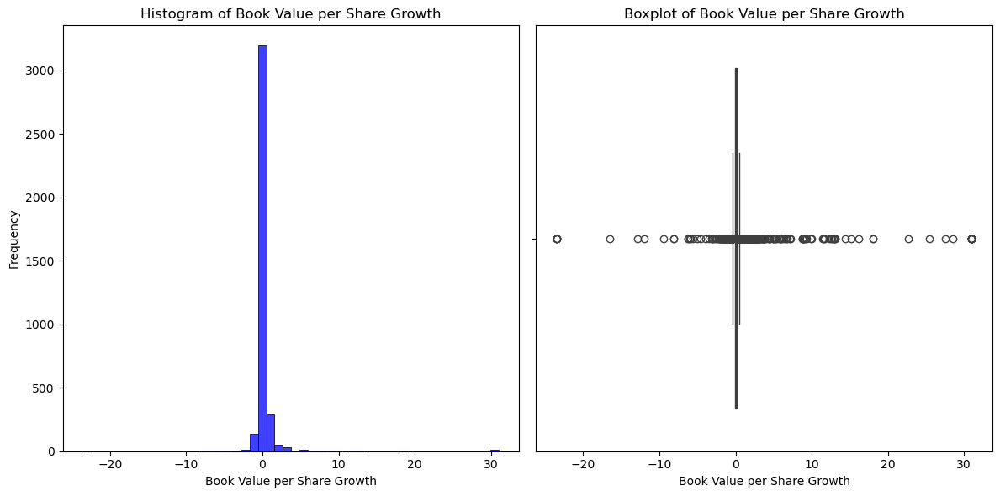

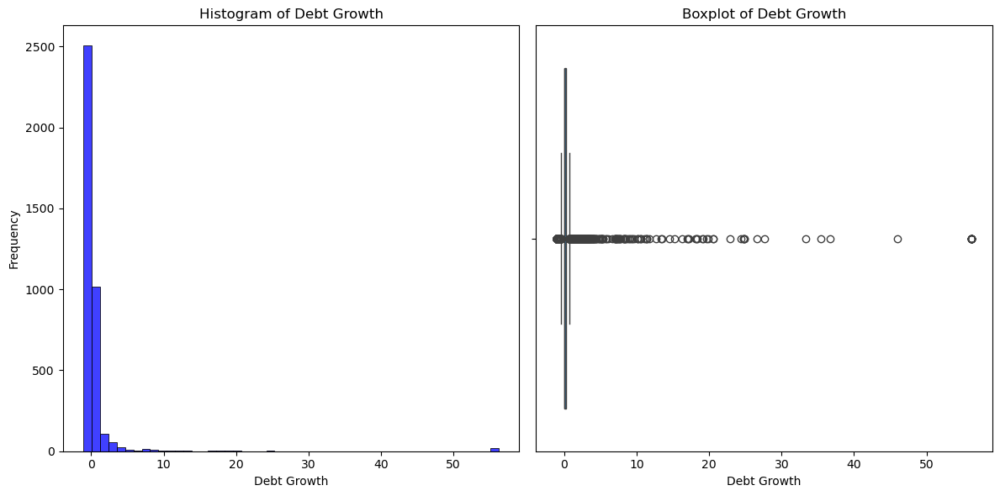

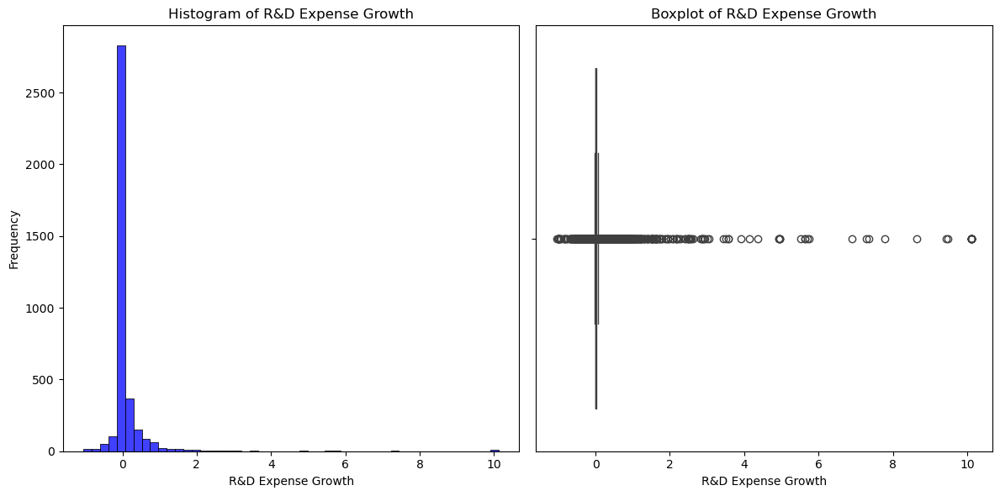

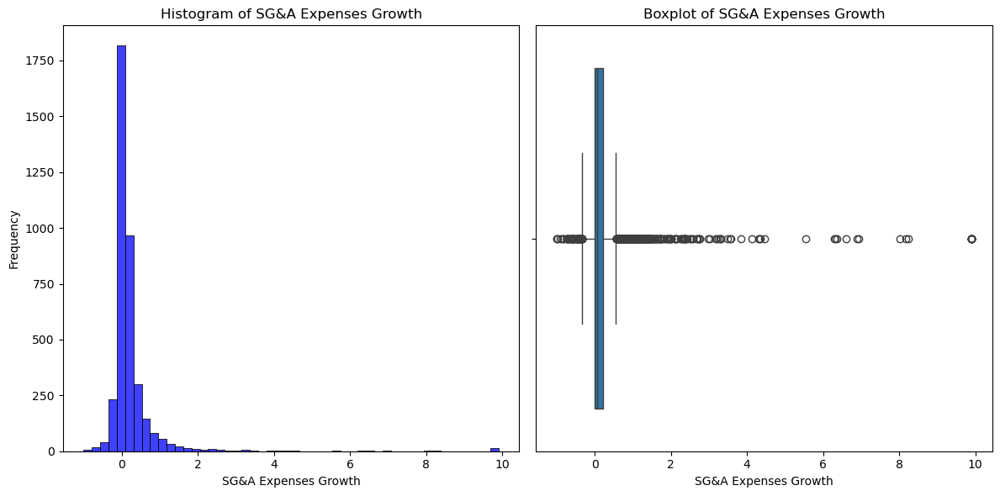

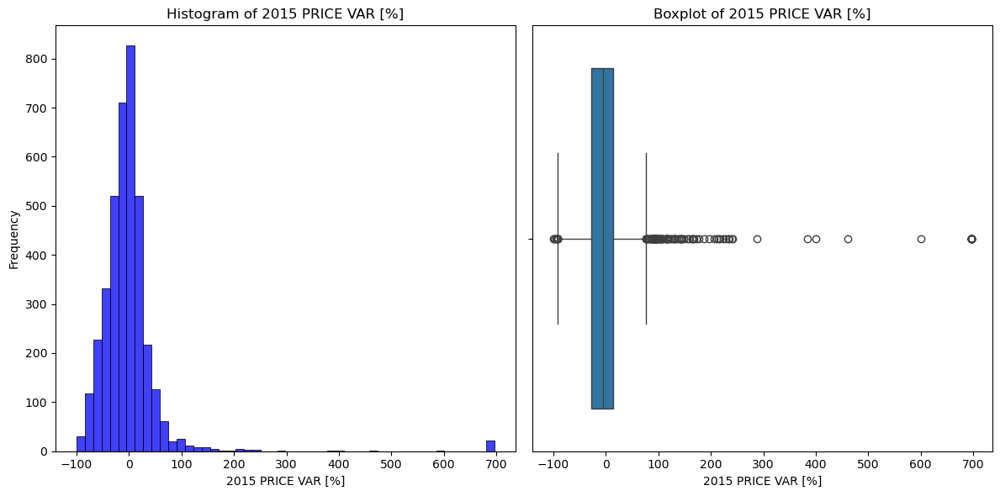

In [177]:
plot_by_year(modified_datasets['2014'])

### **Trimmed Dataset**: 
Outliers will be removed, specifically the lowest and highest 1% of values.

In [179]:
# Create a new dictionary to store the modified datasets
modified_datasets = {}

# Apply the function to each dataset in the dictionary
for year, dataset in all_datasets.items():
    df_modified = dataset.copy()
    for column in df_modified.columns:
        if df_modified[column].dtype in ['int64', 'float64']:  # Check if the column is numeric
            df_modified = handle_outliers(df_modified, column, action='drop', factor=2, quantile_1=0.01, quantile_3=0.99)
    modified_datasets[year] = df_modified  # Store the modified DataFrame
    
print(f'Original Dataset:{all_datasets['2014'].shape}, Modified Dataset {modified_datasets['2014'].shape}')

output_directory = '../data/processed_data/data_drop_outliers_1%'
save_datasets_to_csv(all_datasets, output_directory)

Original Dataset:(3808, 181), Modified Dataset (2821, 181)
Data from 2014 saved to ../data/processed_data/data_drop_outliers_1%/cleaned_df_2014.csv
Data from 2015 saved to ../data/processed_data/data_drop_outliers_1%/cleaned_df_2015.csv
Data from 2016 saved to ../data/processed_data/data_drop_outliers_1%/cleaned_df_2016.csv
Data from 2017 saved to ../data/processed_data/data_drop_outliers_1%/cleaned_df_2017.csv
Data from 2018 saved to ../data/processed_data/data_drop_outliers_1%/cleaned_df_2018.csv


Let's see year 2014

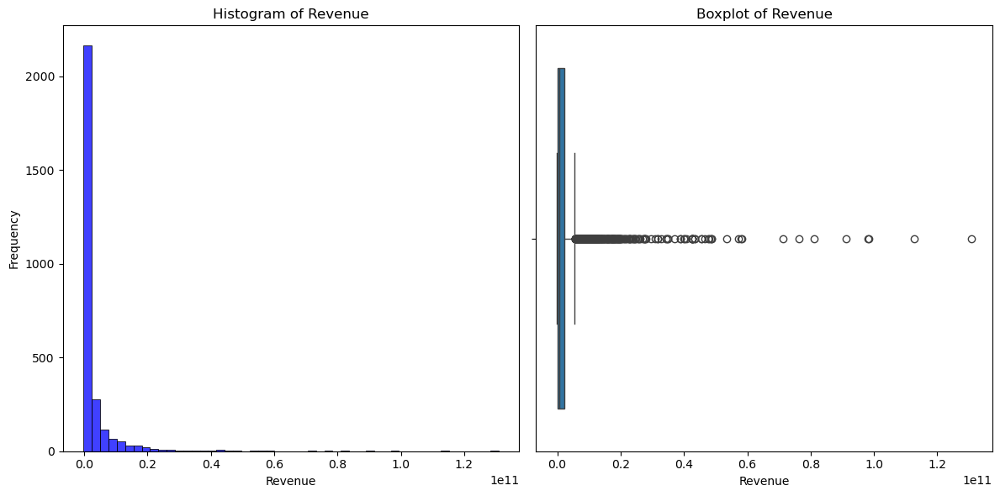

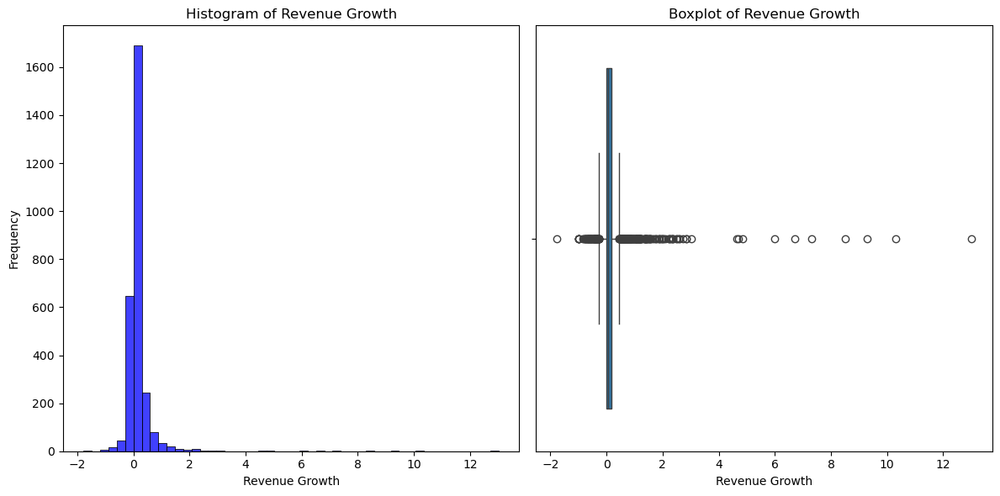

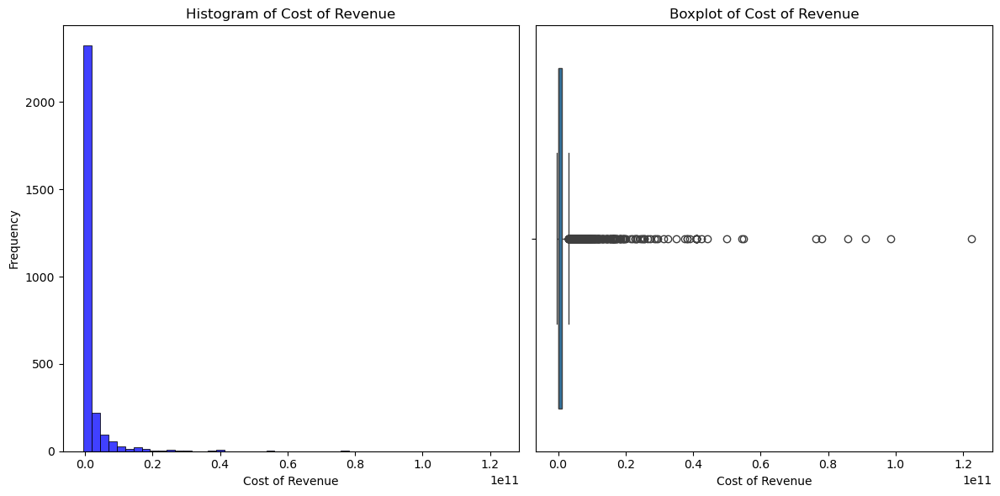

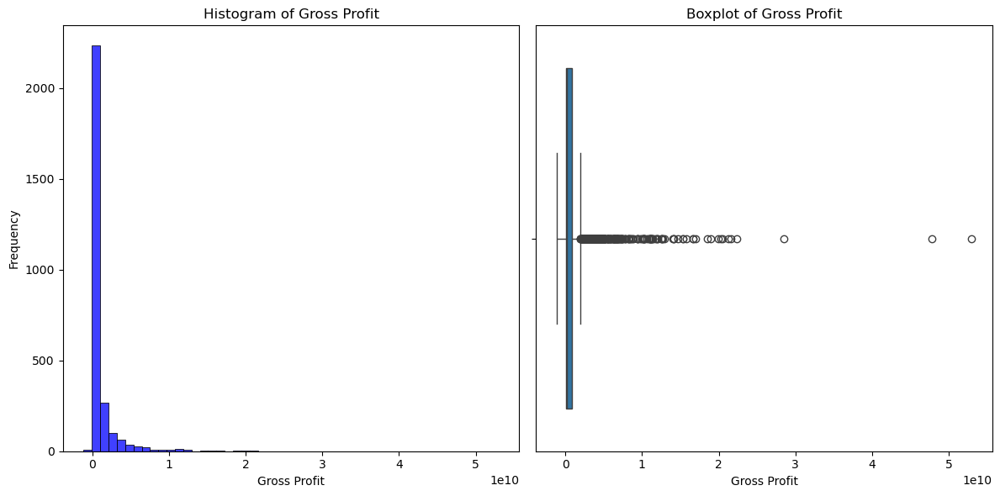

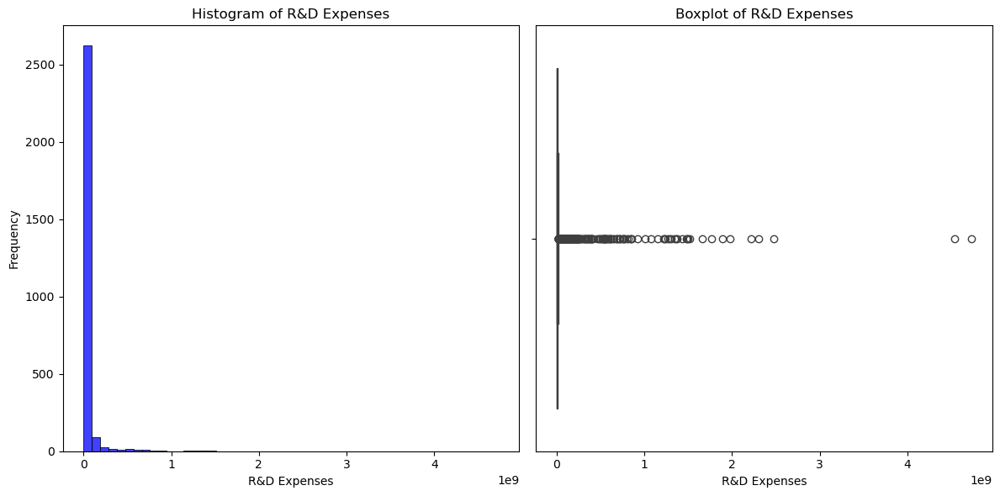

...

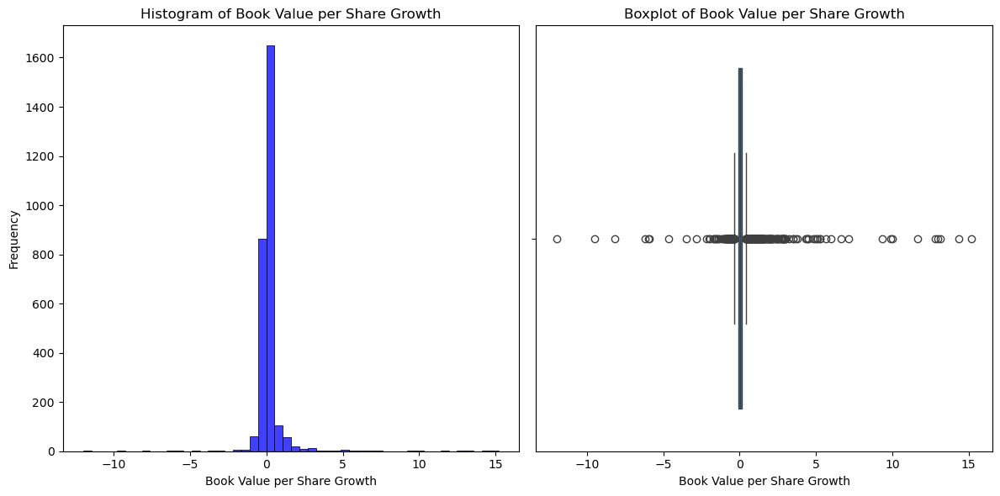

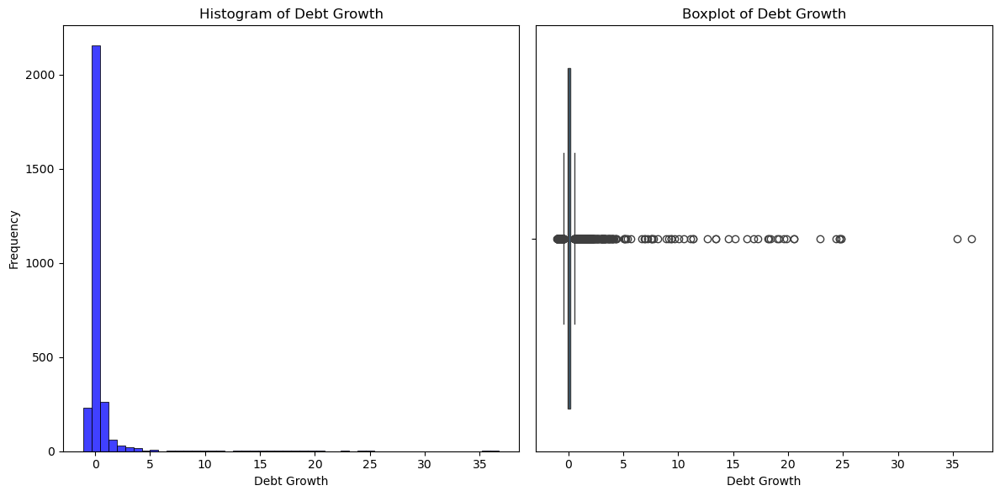

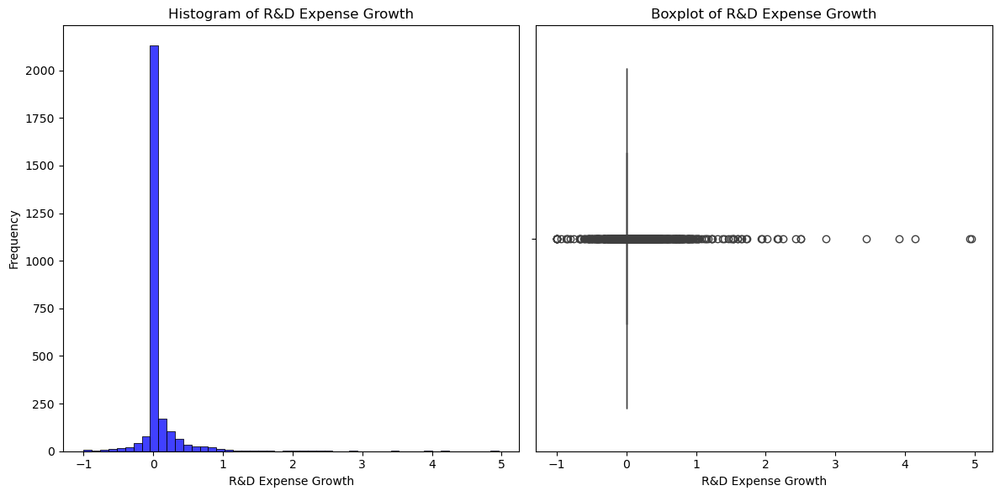

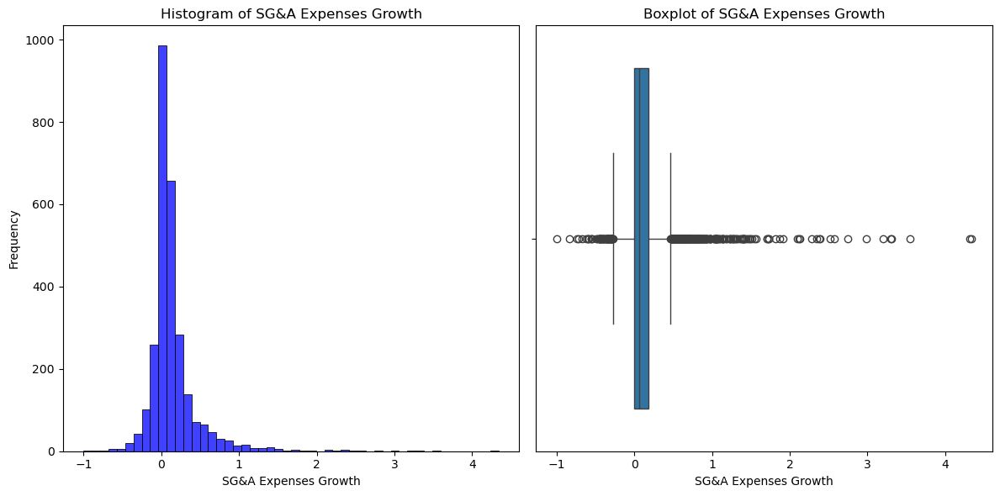

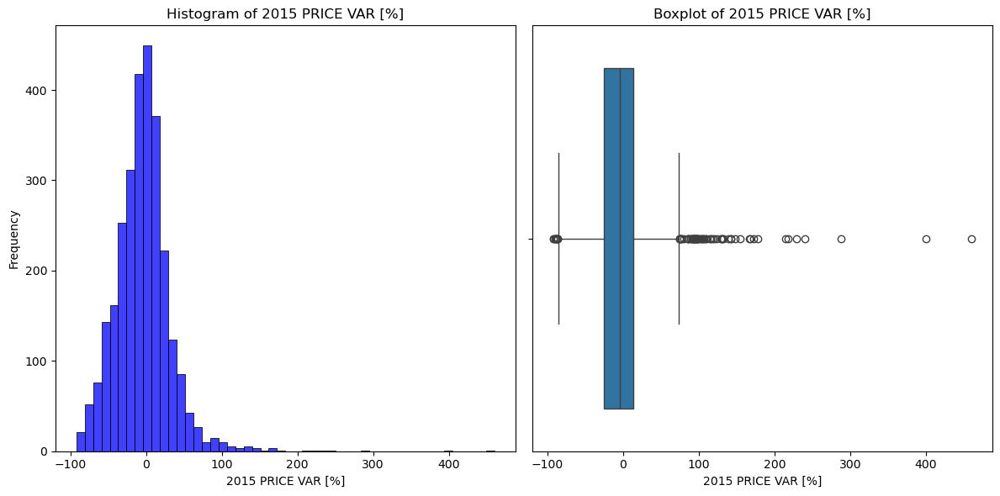

In [180]:
plot_by_year(modified_datasets['2014'])

# Next Steps

The following steps will be undertaken to enhance our analysis:

1. **PCA Analysis**: Perform Principal Component Analysis to reduce dimensionality and identify key features.
2. **Clustering**: Apply clustering techniques to discover inherent groupings within the data.
3. **Feature Engineering**: Develop new features to improve the predictive power and performance of our models.
